# Visualization: Last 48h before Hypoglycemia

In [1]:
# imports
import pandas as pd
import numpy as np
import datetime
import matplotlib.pyplot as plt
import xml.etree.ElementTree as ET
import os
import scipy
import glob

## Functions

In [2]:
# this function creates the time series sequence and takes the values with corresponding classes,
# the wanted sequence lenghth, and the step count as input
def create_dataset(X, y, time_steps=1, step=1):
    Xts, Xglc, Xba, Xbo, Xmacc = [], [], [], [], []
    # sequence lengths which is shorter than the required lenght are not considered
    if (len(X) < time_steps):
        print('too short')
    else:
        for i in range(0, len(X) - time_steps, step):
            label = y.iloc[i+time_steps-1]
            # the plots illustrate the last 48 hours before hypoglycemia threfore only class 1 is considered
            if (label == 1):
                ts = pd.to_datetime(X['ts'].iloc[i:(i + time_steps)].values, format='%Y-%m-%d %H:%M:%S')
                glc = X['glucose'].iloc[i:(i + time_steps)].values.astype(int)
                ba = X['basal'].iloc[i:(i + time_steps)].values
                bo = X['bolus'].iloc[i:(i + time_steps)].values
                macc = X['macc'].iloc[i:(i + time_steps)].values
                Xts.append(ts)
                Xglc.append(glc)
                Xba.append(ba)
                Xbo.append(bo)
                Xmacc.append(macc)
    return np.array(Xts), np.array(Xglc), np.array(Xba), np.array(Xbo), np.array(Xmacc)

In [3]:
# this function plots the last 48 hours before hypoglycemia and takes the subject_id, the modus which acn be
# interpolated or extrapolated, the dtaframes, and the wanted sequence length as input 
# as output, the plots are saved 
def Visualization(subject_id, modus, dataframes, time_steps = 0):
    count = 0
    # it is iterated through each dataframe of each subject and the time sequences are created
    for df in dataframes: 
        subject_id = np.unique(df['Subject_ID'].astype(str).to_numpy())
        subject_id = subject_id[0]
        Xts, Xg, Xba, Xbo, Xm = create_dataset(df[['ts', 'glucose', 'basal', 'bolus', 'macc']], df['Class'], time_steps=time_steps, step=1)
        for i in range (0, Xg.shape[0]):
            data = {'ts': Xts[i], 'glucose': Xg[i], 'basal': Xba[i], 'bolus': Xbo[i], 'macc':  Xm[i]}
            df = pd.DataFrame.from_dict(data)
            df['date'] = pd.to_datetime(df['ts'], format='%Y-%m-%d %H:%M:%S')
            
            fig, ax1 = plt.subplots(figsize=(15, 6), layout='constrained')

            # the thresholds for hypoglycemia and severe hypoglycemia are plotted as straight lines
            ax1.axhline(y=70, color='r', linestyle='--', linewidth=1, label = 'hypoglycemia threshold')
            ax1.axhline(y=54, color='k', linestyle='--', linewidth=1, label = 'severe hypoglycemia threshold')
            
            # for each variable, an axis is instantiated so that every parameter is scaled individually
            # (https://stackoverflow.com/questions/9103166/multiple-axis-in-matplotlib-with-different-scales)
            color = 'tab:blue'
            ax1.set_xlabel('timepoints')
            ax1.set_ylabel('glucose concentration', color=color)
            ax1.plot(df['date'], df['glucose'], color=color,  label='glucose')
            ax1.tick_params(axis='y', labelcolor=color)
            ax1.set_ylim(bottom=0)


            ax2 = ax1.twinx()  
            color = 'tab:cyan'
            ax2.set_ylabel('basal dosage', color=color)  
            ax2.plot(df['date'], df['basal'], color=color, label='basal')
            ax2.tick_params(axis='y', labelcolor=color)
            fig.tight_layout()  

            ax2.set_frame_on(True)
            ax2.patch.set_visible(False)

            ax3 = ax1.twinx()  
            color = 'tab:green'
            ax3.set_ylabel('bolus dosage', color=color)  
            ax3.plot(df['date'], df['bolus'], color=color, label='bolus')
            ax3.tick_params(axis='y', labelcolor=color)
            fig.tight_layout()  

            ax3.spines['right'].set_position(('axes', 1.05))


            ax4 = ax1.twinx() 
            color = 'tab:pink'
            ax4.set_ylabel('magnitude of acceleration', color=color)  
            ax4.plot(df['date'], df['macc'], color=color, label='macc')
            ax4.tick_params(axis='y', labelcolor=color)
            fig.tight_layout()  

            ax4.spines['right'].set_position(('axes', 1.1))


            ax4.set_frame_on(True)
            ax4.patch.set_visible(False)

            # the legend for all axis are concatenated and plotted together
            lines, labels = ax1.get_legend_handles_labels()
            lines2, labels2 = ax2.get_legend_handles_labels()
            lines3, labels3 = ax3.get_legend_handles_labels()
            lines4, labels4 = ax4.get_legend_handles_labels()
            ax1.legend(lines + lines2 + lines3 + lines4, labels + labels2 + labels3 + labels4 , loc='upper center', bbox_to_anchor=(0.5, -0.15), ncol=4)

            file_name = "Images/%s/%s/%i.png" % (modus, subject_id, count)
            count = count + 1

            # the figure is saved
            plt.title('Parameters in the last 48 hours before the hypoglycemic event for subject: ' + subject_id)
            plt.savefig(file_name, bbox_inches = 'tight')

## Plots of interpolated data

too short


/var/folders/t1/sgksm9r9385br4pts_lckj1w0000gn/T/ipykernel_5468/142188250.py:31: UserWarning: The figure layout has changed to tight
  fig.tight_layout()  # otherwise the right y-label is slightly clipped
/var/folders/t1/sgksm9r9385br4pts_lckj1w0000gn/T/ipykernel_5468/142188250.py:41: UserWarning: The figure layout has changed to tight
  fig.tight_layout()  # otherwise the right y-label is slightly clipped
/var/folders/t1/sgksm9r9385br4pts_lckj1w0000gn/T/ipykernel_5468/142188250.py:51: UserWarning: The figure layout has changed to tight
  fig.tight_layout()  # otherwise the right y-label is slightly clipped
/var/folders/t1/sgksm9r9385br4pts_lckj1w0000gn/T/ipykernel_5468/142188250.py:31: UserWarning: The figure layout has changed to tight
  fig.tight_layout()  # otherwise the right y-label is slightly clipped
/var/folders/t1/sgksm9r9385br4pts_lckj1w0000gn/T/ipykernel_5468/142188250.py:41: UserWarning: The figure layout has changed to tight
  fig.tight_layout()  # otherwise the right y-l

too short


/var/folders/t1/sgksm9r9385br4pts_lckj1w0000gn/T/ipykernel_5468/142188250.py:31: UserWarning: The figure layout has changed to tight
  fig.tight_layout()  # otherwise the right y-label is slightly clipped
/var/folders/t1/sgksm9r9385br4pts_lckj1w0000gn/T/ipykernel_5468/142188250.py:41: UserWarning: The figure layout has changed to tight
  fig.tight_layout()  # otherwise the right y-label is slightly clipped
/var/folders/t1/sgksm9r9385br4pts_lckj1w0000gn/T/ipykernel_5468/142188250.py:51: UserWarning: The figure layout has changed to tight
  fig.tight_layout()  # otherwise the right y-label is slightly clipped
/var/folders/t1/sgksm9r9385br4pts_lckj1w0000gn/T/ipykernel_5468/142188250.py:31: UserWarning: The figure layout has changed to tight
  fig.tight_layout()  # otherwise the right y-label is slightly clipped
/var/folders/t1/sgksm9r9385br4pts_lckj1w0000gn/T/ipykernel_5468/142188250.py:41: UserWarning: The figure layout has changed to tight
  fig.tight_layout()  # otherwise the right y-l

too short


/var/folders/t1/sgksm9r9385br4pts_lckj1w0000gn/T/ipykernel_5468/142188250.py:31: UserWarning: The figure layout has changed to tight
  fig.tight_layout()  # otherwise the right y-label is slightly clipped
/var/folders/t1/sgksm9r9385br4pts_lckj1w0000gn/T/ipykernel_5468/142188250.py:41: UserWarning: The figure layout has changed to tight
  fig.tight_layout()  # otherwise the right y-label is slightly clipped
/var/folders/t1/sgksm9r9385br4pts_lckj1w0000gn/T/ipykernel_5468/142188250.py:51: UserWarning: The figure layout has changed to tight
  fig.tight_layout()  # otherwise the right y-label is slightly clipped
/var/folders/t1/sgksm9r9385br4pts_lckj1w0000gn/T/ipykernel_5468/142188250.py:31: UserWarning: The figure layout has changed to tight
  fig.tight_layout()  # otherwise the right y-label is slightly clipped
/var/folders/t1/sgksm9r9385br4pts_lckj1w0000gn/T/ipykernel_5468/142188250.py:41: UserWarning: The figure layout has changed to tight
  fig.tight_layout()  # otherwise the right y-l

too short


/var/folders/t1/sgksm9r9385br4pts_lckj1w0000gn/T/ipykernel_5468/142188250.py:31: UserWarning: The figure layout has changed to tight
  fig.tight_layout()  # otherwise the right y-label is slightly clipped
/var/folders/t1/sgksm9r9385br4pts_lckj1w0000gn/T/ipykernel_5468/142188250.py:41: UserWarning: The figure layout has changed to tight
  fig.tight_layout()  # otherwise the right y-label is slightly clipped
/var/folders/t1/sgksm9r9385br4pts_lckj1w0000gn/T/ipykernel_5468/142188250.py:51: UserWarning: The figure layout has changed to tight
  fig.tight_layout()  # otherwise the right y-label is slightly clipped
/var/folders/t1/sgksm9r9385br4pts_lckj1w0000gn/T/ipykernel_5468/142188250.py:31: UserWarning: The figure layout has changed to tight
  fig.tight_layout()  # otherwise the right y-label is slightly clipped
/var/folders/t1/sgksm9r9385br4pts_lckj1w0000gn/T/ipykernel_5468/142188250.py:41: UserWarning: The figure layout has changed to tight
  fig.tight_layout()  # otherwise the right y-l

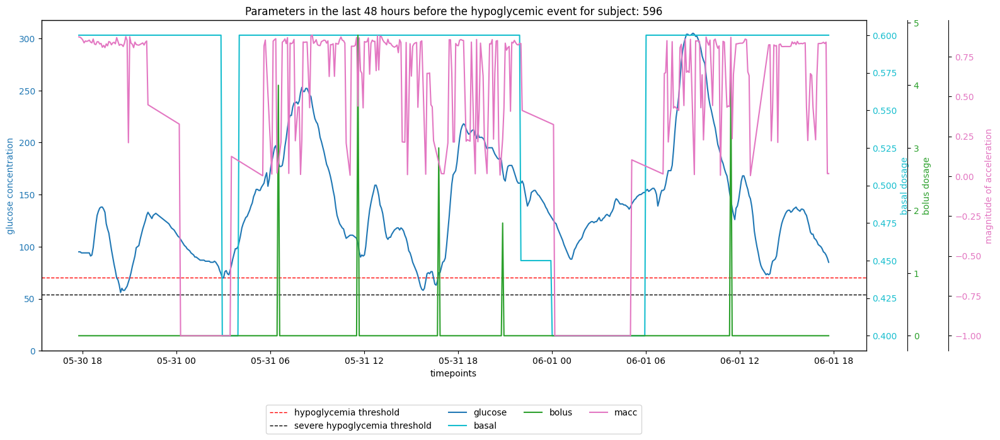

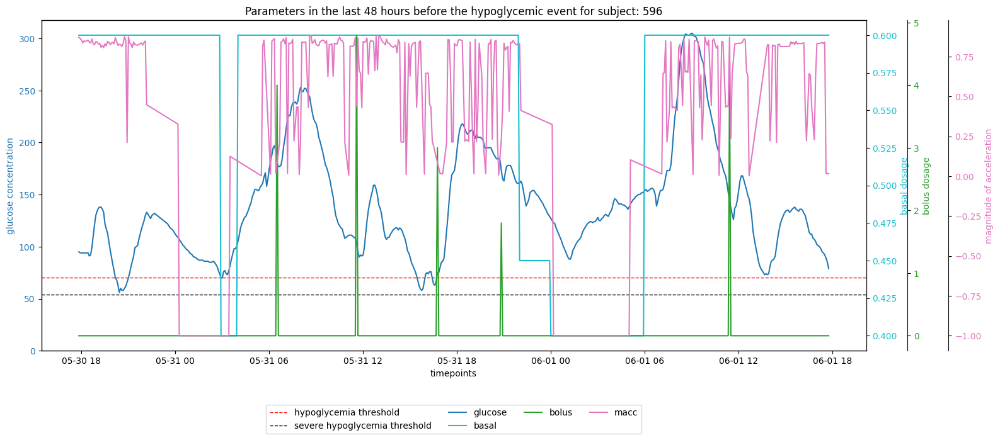

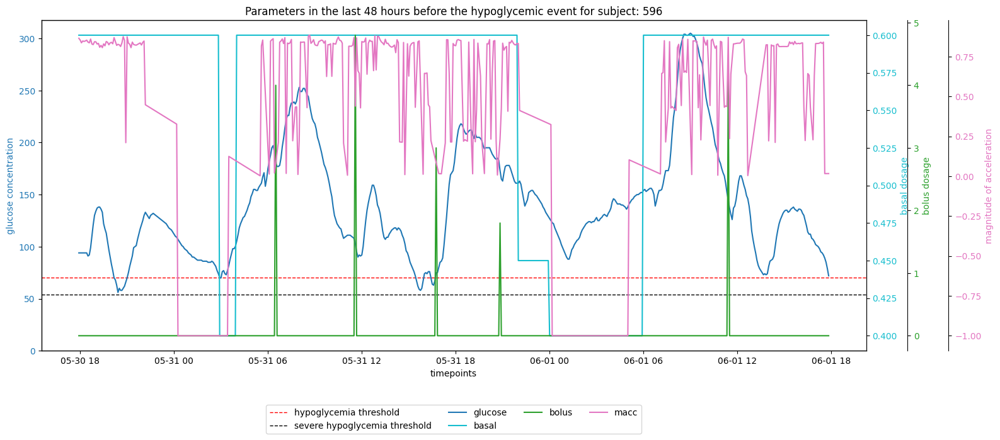

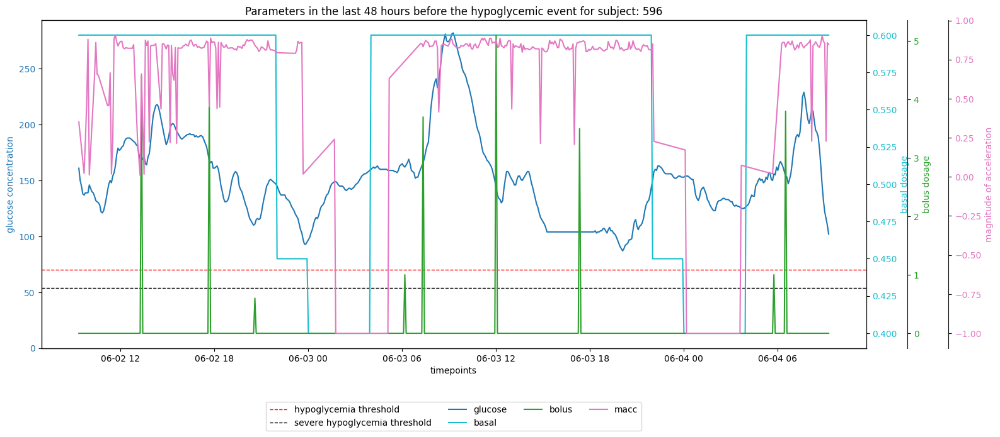

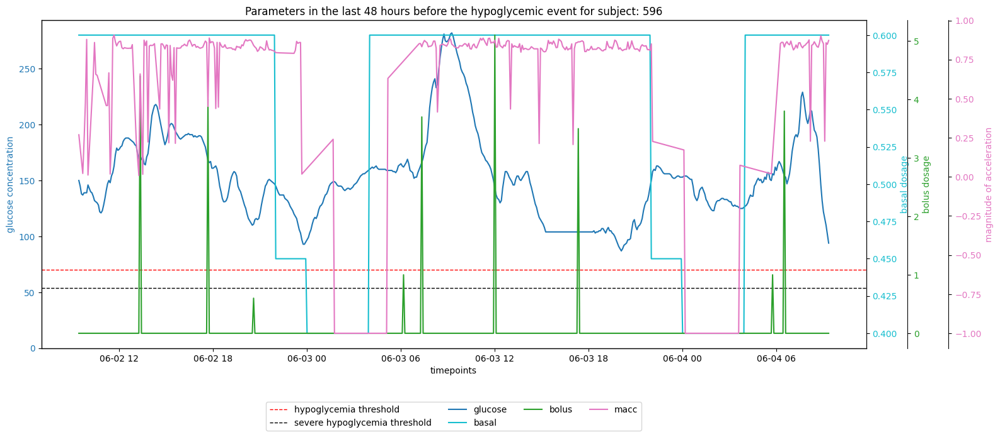

...

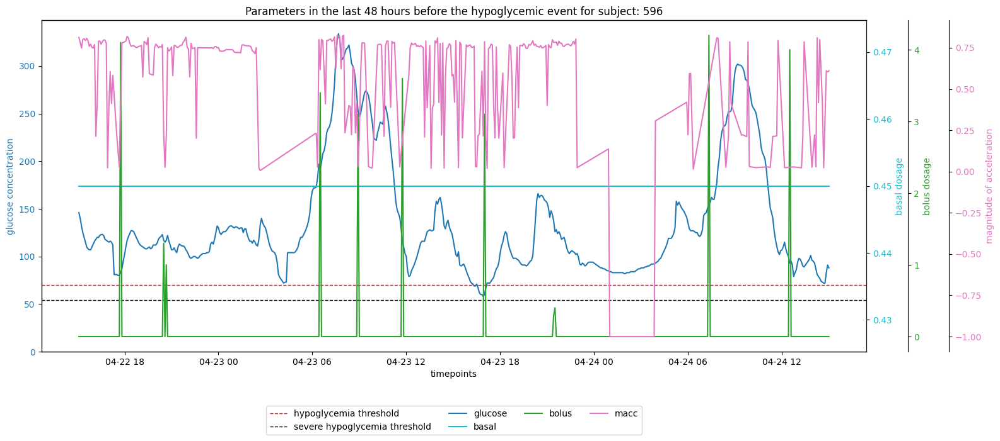

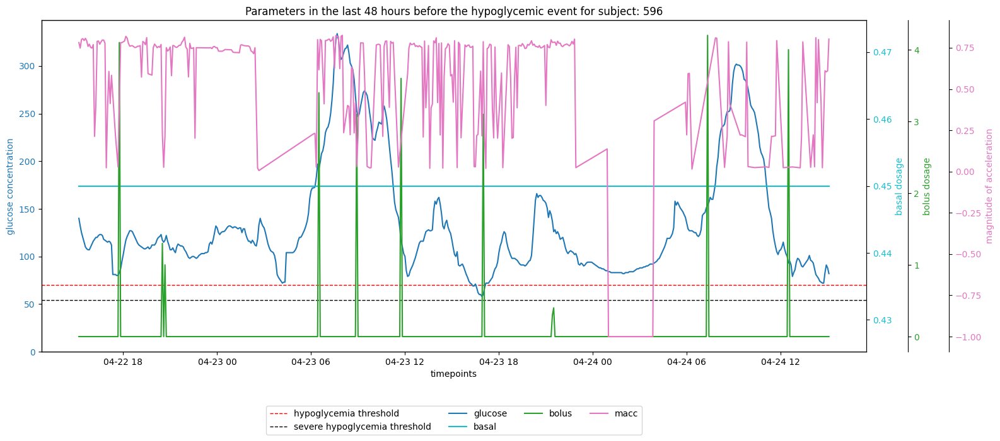

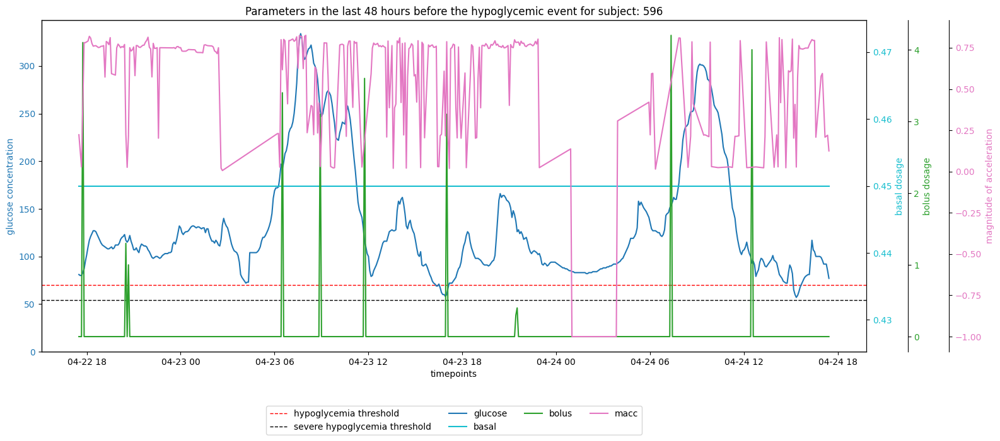

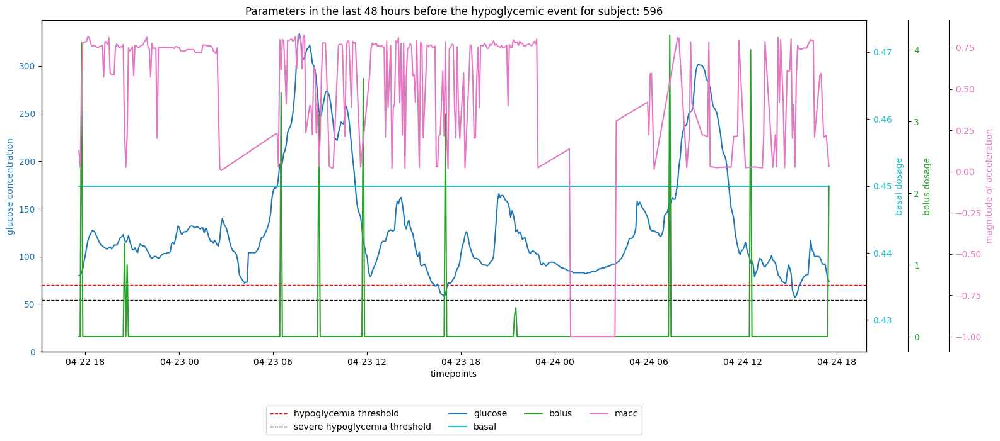

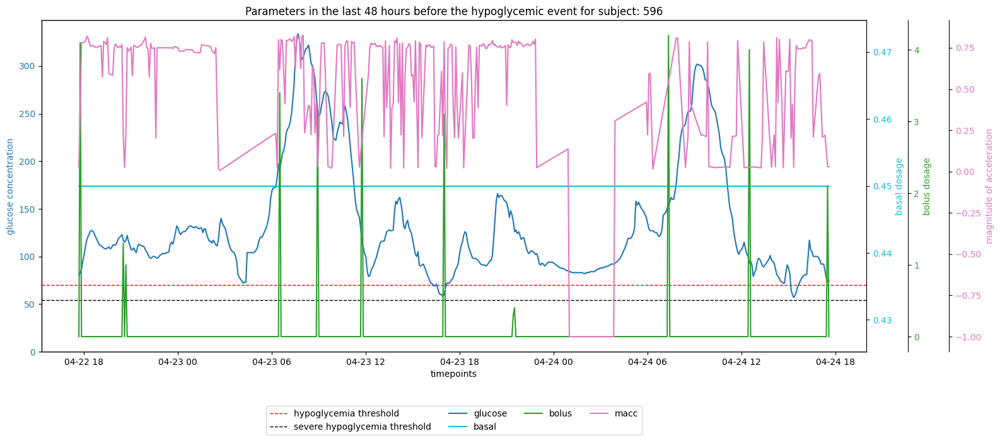

In [7]:
# empty array to store all dataframes of all subjects 
frames = []
# array with subject ids so that it can be iterated over each person
subject_IDs = ['540', '544', '552', '559', '563', '567','570', '575', '584', '588', '591', '596']
path = '/GAPS_DATA/TRAIN/'

# it is iterated over each subject
for subject_id in subject_IDs:
# all paths of csv files are stored in array
    csv_files = glob.glob(path + subject_id + "/*.csv")
    # each dataframe is loaded and all dataframes are stored in one array
    for file in csv_files:
        df = pd.read_csv(file)
        frames.append(df)
    # the Visualization function is called for 48 hours which make 576 time steps
    Visualization(subject_id, 'Interpolated', frames, time_steps = 576) 

## Plots of extrapolated data

/var/folders/t1/sgksm9r9385br4pts_lckj1w0000gn/T/ipykernel_5468/142188250.py:31: UserWarning: The figure layout has changed to tight
  fig.tight_layout()  # otherwise the right y-label is slightly clipped
/var/folders/t1/sgksm9r9385br4pts_lckj1w0000gn/T/ipykernel_5468/142188250.py:41: UserWarning: The figure layout has changed to tight
  fig.tight_layout()  # otherwise the right y-label is slightly clipped
/var/folders/t1/sgksm9r9385br4pts_lckj1w0000gn/T/ipykernel_5468/142188250.py:51: UserWarning: The figure layout has changed to tight
  fig.tight_layout()  # otherwise the right y-label is slightly clipped
/var/folders/t1/sgksm9r9385br4pts_lckj1w0000gn/T/ipykernel_5468/142188250.py:31: UserWarning: The figure layout has changed to tight
  fig.tight_layout()  # otherwise the right y-label is slightly clipped
/var/folders/t1/sgksm9r9385br4pts_lckj1w0000gn/T/ipykernel_5468/142188250.py:41: UserWarning: The figure layout has changed to tight
  fig.tight_layout()  # otherwise the right y-l

too short
too short


/var/folders/t1/sgksm9r9385br4pts_lckj1w0000gn/T/ipykernel_5468/142188250.py:31: UserWarning: The figure layout has changed to tight
  fig.tight_layout()  # otherwise the right y-label is slightly clipped
/var/folders/t1/sgksm9r9385br4pts_lckj1w0000gn/T/ipykernel_5468/142188250.py:41: UserWarning: The figure layout has changed to tight
  fig.tight_layout()  # otherwise the right y-label is slightly clipped
/var/folders/t1/sgksm9r9385br4pts_lckj1w0000gn/T/ipykernel_5468/142188250.py:51: UserWarning: The figure layout has changed to tight
  fig.tight_layout()  # otherwise the right y-label is slightly clipped
/var/folders/t1/sgksm9r9385br4pts_lckj1w0000gn/T/ipykernel_5468/142188250.py:31: UserWarning: The figure layout has changed to tight
  fig.tight_layout()  # otherwise the right y-label is slightly clipped
/var/folders/t1/sgksm9r9385br4pts_lckj1w0000gn/T/ipykernel_5468/142188250.py:41: UserWarning: The figure layout has changed to tight
  fig.tight_layout()  # otherwise the right y-l

too short


/var/folders/t1/sgksm9r9385br4pts_lckj1w0000gn/T/ipykernel_5468/142188250.py:31: UserWarning: The figure layout has changed to tight
  fig.tight_layout()  # otherwise the right y-label is slightly clipped
/var/folders/t1/sgksm9r9385br4pts_lckj1w0000gn/T/ipykernel_5468/142188250.py:41: UserWarning: The figure layout has changed to tight
  fig.tight_layout()  # otherwise the right y-label is slightly clipped
/var/folders/t1/sgksm9r9385br4pts_lckj1w0000gn/T/ipykernel_5468/142188250.py:51: UserWarning: The figure layout has changed to tight
  fig.tight_layout()  # otherwise the right y-label is slightly clipped
/var/folders/t1/sgksm9r9385br4pts_lckj1w0000gn/T/ipykernel_5468/142188250.py:31: UserWarning: The figure layout has changed to tight
  fig.tight_layout()  # otherwise the right y-label is slightly clipped
/var/folders/t1/sgksm9r9385br4pts_lckj1w0000gn/T/ipykernel_5468/142188250.py:41: UserWarning: The figure layout has changed to tight
  fig.tight_layout()  # otherwise the right y-l

too short


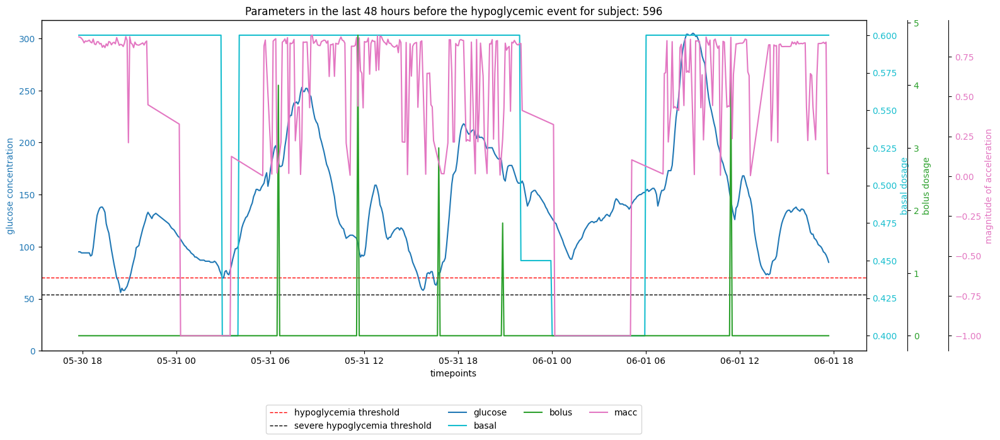

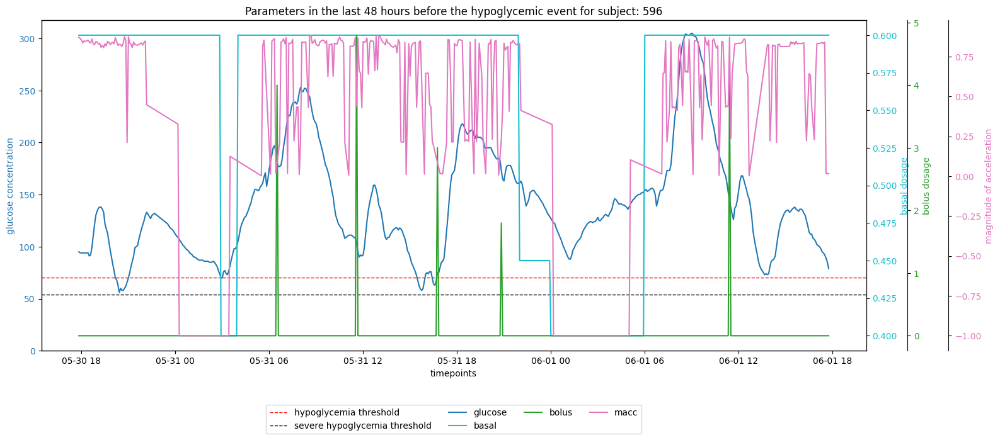

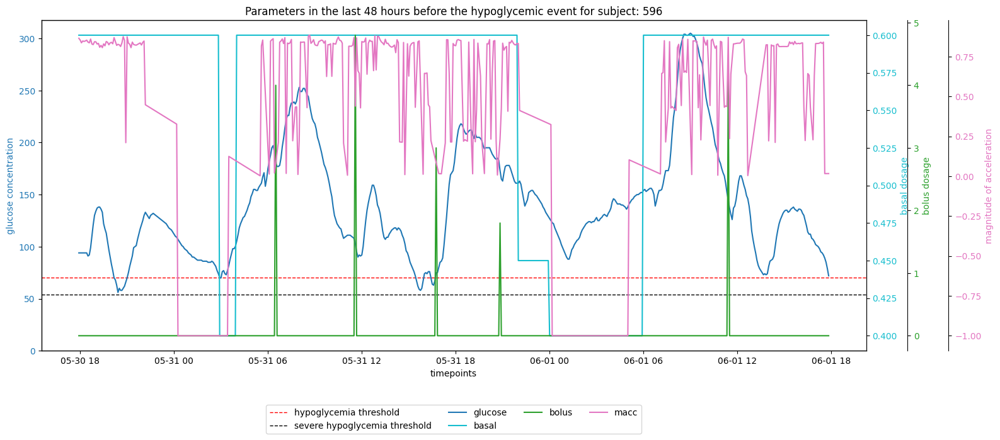

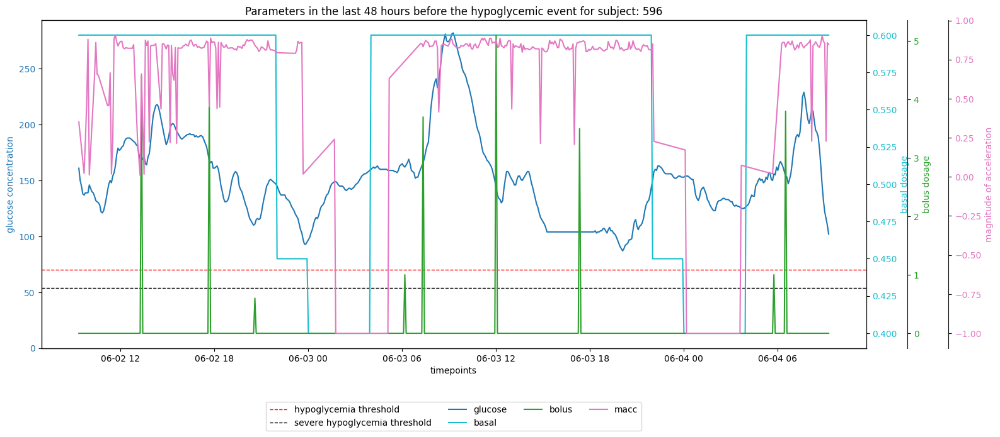

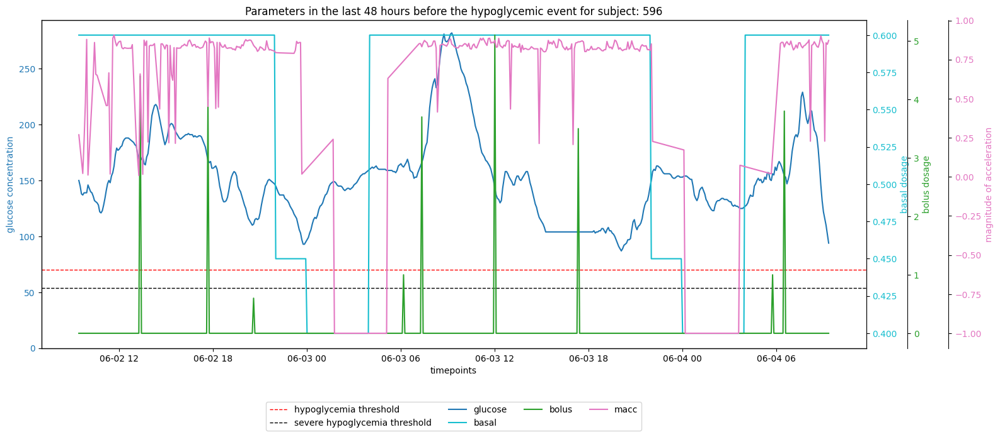

...

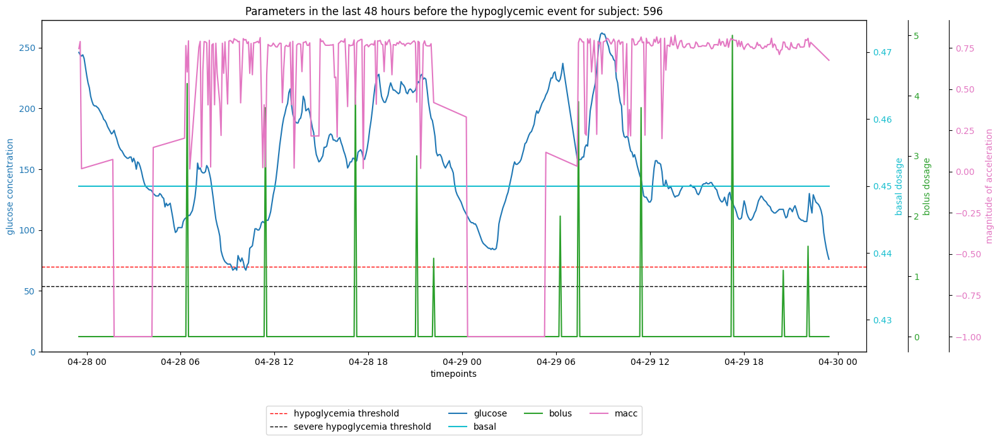

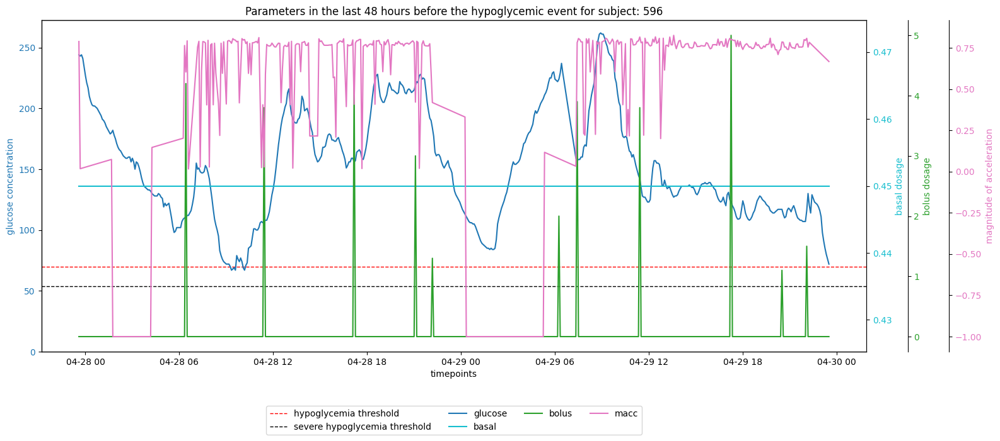

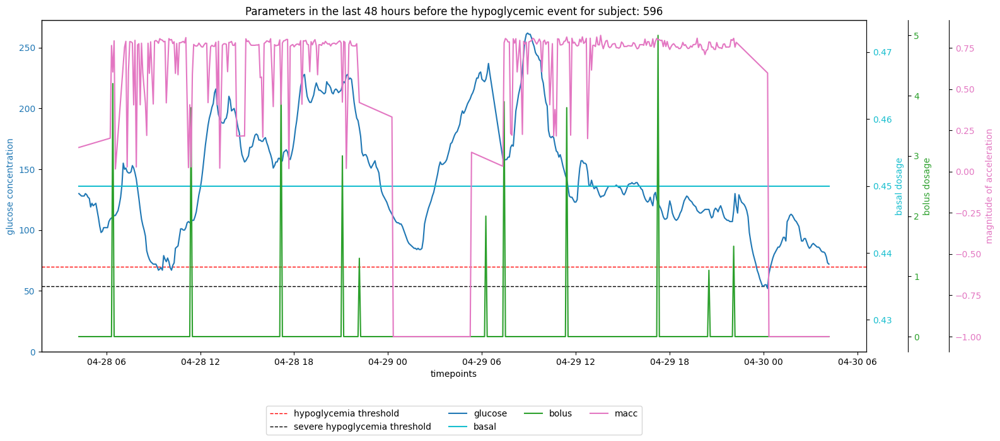

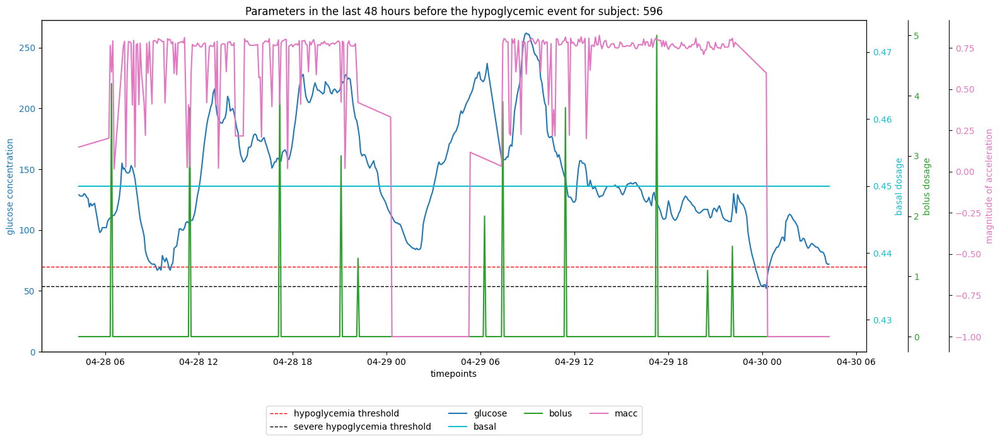

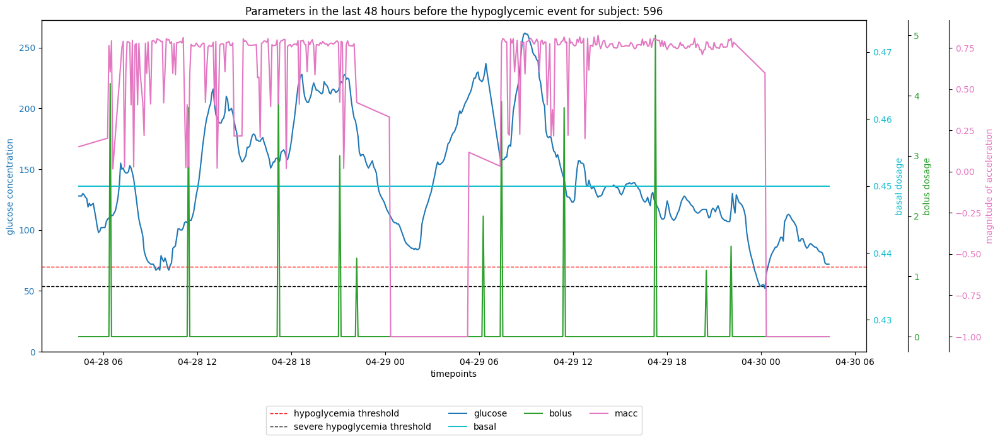

In [6]:
# empty array to store all dataframes of all subjects 
frames = []
# array with subject ids so that we it can be iterated over each person
subject_IDs = ['540', '544', '552', '559', '563', '567','570', '575', '584', '588', '591', '596']
path = '/GAPS_DATA/TEST/'

# it is iterated over each subject
for subject_id in subject_IDs:
# all paths of csv files are stored in array
    csv_files = glob.glob(path + subject_id + "/*.csv")
    # each dataframe is loaded and all dataframes are stored in one array
    for file in csv_files:
        df = pd.read_csv(file)
        frames.append(df)
    # the Visualization function is called for 48 hours which make 576 time steps
    Visualization(subject_id, 'Extrapolated', frames, time_steps = 576) 